# Implementation of [Understanding intermediate layers using linear classifier probes by G. Alain (2016)](https://arxiv.org/abs/1610.01644)

## Dependencies

In [1]:
# to get the JSAnimation library
# !pip install git+http://github.com/jakevdp/JSAnimation

## Introduction

In this notebook, we reproduce results from the paper with slightly different hyperparameters. We also use closed form solutions and a random sample of features and training samples to speed up the training. The size of the mini batches is bigger and we use a smaller learning rate so that our animations are smoother.

## Imports

In [2]:
from __future__ import print_function
import numpy as np
np.random.seed(1337)  # for reproducibility


from keras.datasets import mnist
from keras.models import Model
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Convolution2D, MaxPooling2D, Input, merge
from keras.layers.advanced_activations import LeakyReLU
from keras.utils import np_utils
from keras import backend as K
from keras.optimizers import Adam
from sklearn.linear_model import LogisticRegression

# comment this section if you are using Theano
import tensorflow as tf

config = tf.ConfigProto(allow_soft_placement=True)
config.gpu_options.allow_growth = True
session = tf.Session(config=config)
K.set_session(session)

Using TensorFlow backend.


In [3]:
%matplotlib inline
import seaborn as sns

from matplotlib import animation, rc
from IPython.display import HTML
from matplotlib import pyplot as plt
from matplotlib import animation
from JSAnimation.IPython_display import display_animation
from matplotlib.pyplot import subplot2grid

## Data imports

In [4]:
batch_size = 512
nb_classes = 10
nb_epoch = 250
r_features = 75

# input image dimensions
img_rows, img_cols = 28, 28
# number of convolutional filters to use
nb_filters = 32
# size of pooling area for max pooling
pool_size = (2, 2)
# convolution kernel size
kernel_size = (5, 5)

# the data, shuffled and split between train and test sets
(X_train, y_train), (X_test, y_test) = mnist.load_data()

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')
X_train /= 255
X_test /= 255
print('X_train shape:', X_train.shape)
print(X_train.shape[0], 'train samples')
print(X_test.shape[0], 'test samples')

if K.image_dim_ordering() == 'th':
    X_train = X_train.reshape(X_train.shape[0], 1, img_rows, img_cols)
    X_test = X_test.reshape(X_test.shape[0], 1, img_rows, img_cols)
    input_shape = (1, img_rows, img_cols)
else:
    X_train = X_train.reshape(X_train.shape[0], img_rows, img_cols, 1)
    X_test = X_test.reshape(X_test.shape[0], img_rows, img_cols, 1)
    input_shape = (img_rows, img_cols, 1)


# convert class vectors to binary class matrices
Y_train = np_utils.to_categorical(y_train, nb_classes)
Y_test = np_utils.to_categorical(y_test, nb_classes)

X_train shape: (60000, 28, 28)
60000 train samples
10000 test samples


## Simple Convolutionnal NNet

In [5]:
input_convnet = Input(shape=input_shape)

conv1 = Convolution2D(nb_filters, kernel_size[0], kernel_size[1],
                      border_mode='valid')
act1 = Activation('relu')
maxpool1 = MaxPooling2D(pool_size=pool_size)

conv2 = Convolution2D(nb_filters, kernel_size[0], kernel_size[1])
act2 = Activation('relu')
maxpool2 = MaxPooling2D(pool_size=pool_size)

flatten_l = Flatten()
dense1 = Dense(128)
act3 = Activation('relu')
out = Dense(nb_classes)
out_act = Activation('softmax')


# apply the layers and get tensors
conv1_preact = conv1(input_convnet)
conv1_postact = act1(conv1_preact)
conv1_postpool = maxpool1(conv1_postact)

conv2_preact = conv2(conv1_postpool)
conv2_postact = act2(conv2_preact)
conv2_postpool = maxpool2(conv2_postact)

flattened = flatten_l(conv2_postpool)
fc1_preact = dense1(flattened)
fc1_postact = act3(fc1_preact)

logits_preact = out(fc1_postact)
logits_postact = out_act(logits_preact)

model = Model(input_convnet, logits_postact)

adam = Adam(lr=0.00001)

model.compile(loss='categorical_crossentropy',
              optimizer=adam,
              metrics=['accuracy'])

In [6]:
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, 28, 28, 1)     0                                            
____________________________________________________________________________________________________
convolution2d_1 (Convolution2D)  (None, 24, 24, 32)    832         input_1[0][0]                    
____________________________________________________________________________________________________
activation_1 (Activation)        (None, 24, 24, 32)    0           convolution2d_1[0][0]            
____________________________________________________________________________________________________
maxpooling2d_1 (MaxPooling2D)    (None, 12, 12, 32)    0           activation_1[0][0]               
___________________________________________________________________________________________

## Probes

Here we define two helper functions to build auxiliary Keras models and outputs.

The first function build the feature extraction parts (forward pass) from the input to a particular layer of the network. These features will be used to train the linear models providing the probes.

The second function build an auxiliary output that could be used and added to the same model.

In [7]:
def build_model_probs(input_probs, tensor, flatten=True):
    if flatten:
        flattened = flatten_l(tensor)
    else:
        flattened = tensor
    probs_model = Model(input_probs, flattened)
    return probs_model

def build_inter_output(tensor, flatten=True):
    if flatten:
        flattened = flatten_l(tensor)
    else:
        flattened = tensor

    out = Dense(nb_classes)
    out_act = Activation('softmax')
    
    logits_preact = out(flattened)
    logits_postact = out_act(logits_preact)

    return logits_postact

We build the feature extraction models for the convnet.

In [8]:
model_conv_1_preact = build_model_probs(input_convnet, conv1_preact)
model_conv_1_postact = build_model_probs(input_convnet, conv1_postact)
model_conv_1_postpool = build_model_probs(input_convnet, conv1_postpool)

model_conv_2_preact = build_model_probs(input_convnet, conv2_preact)
model_conv_2_postact = build_model_probs(input_convnet, conv2_postact)
model_conv_2_postpool = build_model_probs(input_convnet, conv2_postpool)

We will use closed form solutions for the logistic regression problems that we train at each iteration to obtain the probes. Because the first layers of the network will output a lot of features, we use a random sample of the observations and the features to train these models.

At each iteration, we reuse the solution obtained during the previous iteration for the logistic regression models to speed up the convergence.

In [ ]:
scikit = True
all_history = []
obs_sample = np.random.choice(X_train.shape[0], 2000)
X_train_sub = X_train[obs_sample]
Y_train_sub = np.argmax(Y_train[obs_sample], axis=1)
all_layers_conv = [model_conv_1_preact, model_conv_1_postact,
                 model_conv_1_postpool, model_conv_2_preact,
                 model_conv_2_postact, model_conv_2_postpool]

probs_model = {l: LogisticRegression(warm_start=True) for l in all_layers_conv}
loss = []
acc = []
for i in range(nb_epoch):
    probs_histories = []

    for model_prob in all_layers_conv:
        if scikit:
            logreg = probs_model[model_prob]
            features = model_prob.predict(X_train_sub)
            if features.shape[1] > r_features:
                col_sample = np.random.choice(features.shape[1], r_features)
                features = features[:, col_sample]
            logreg.fit(features, Y_train_sub)
            score = logreg.score(features, Y_train_sub)
            probs_histories.append(score)
        else:
            pass
    history = model.fit(X_train, Y_train, nb_epoch=1, batch_size=batch_size)
    ite_loss = loss + [history.history['loss']]
    loss = loss + [history.history['loss']]
    ite_acc = acc + [history.history['acc']]
    acc = acc + [history.history['acc']]
    
    all_history.append(((ite_loss, ite_acc), probs_histories))

We then plot the evolution of the probes (classification error) and the classification accuracy of the main model.

This animation is similar to [this video](https://www.youtube.com/watch?v=x8j4ZHCR2FI&feature=youtu.be) and to figure 5a and 5b from the paper.


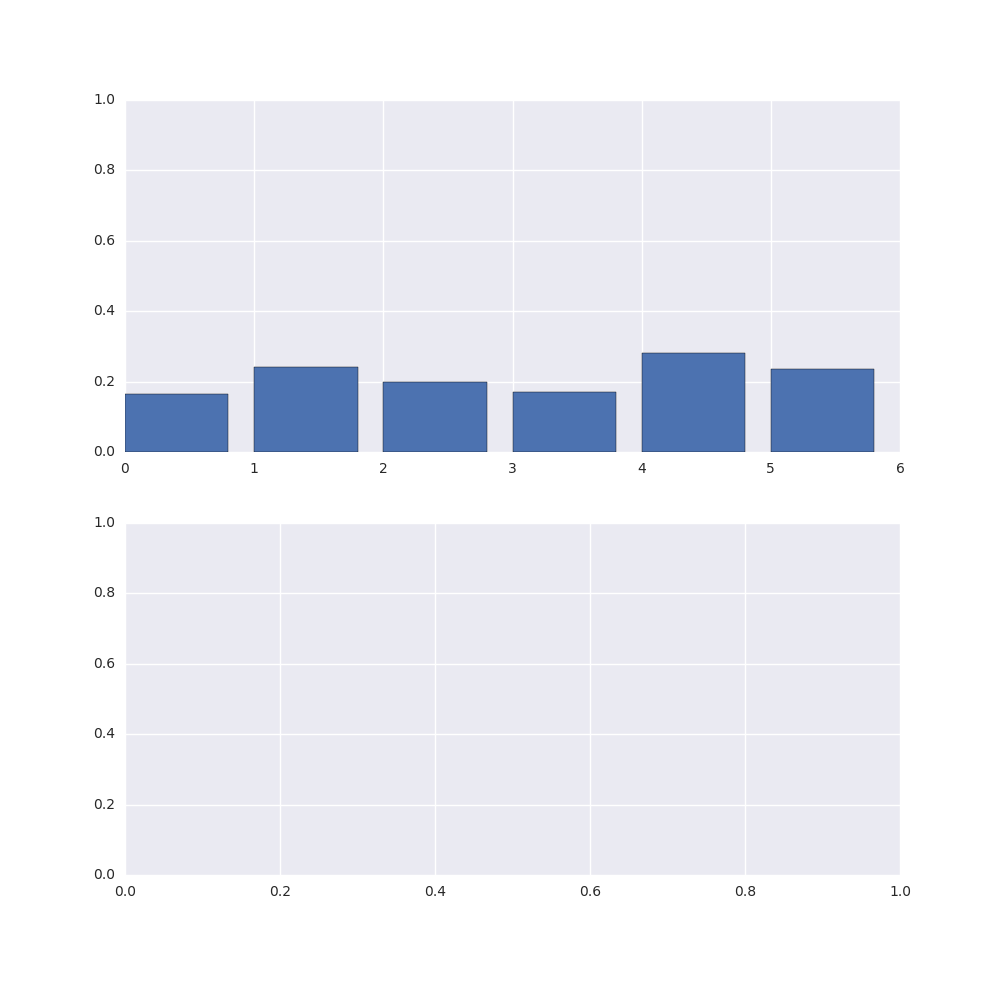
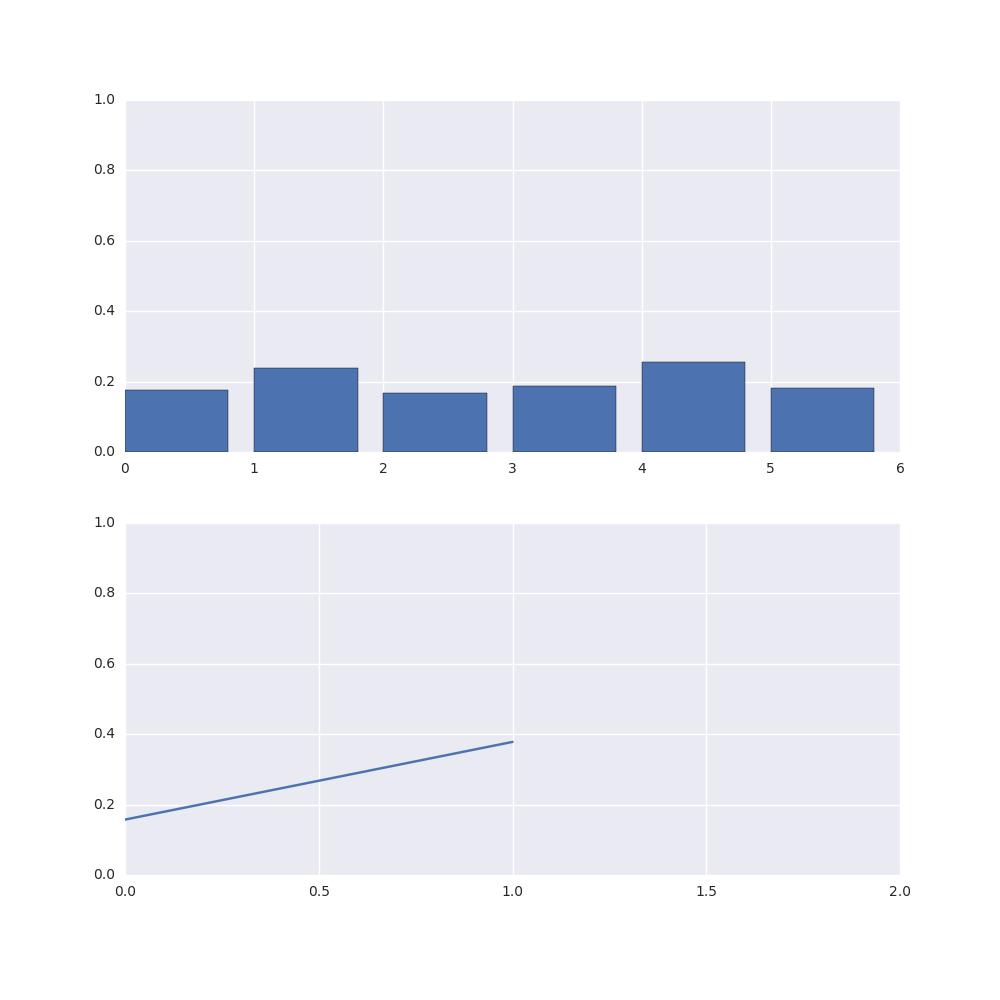
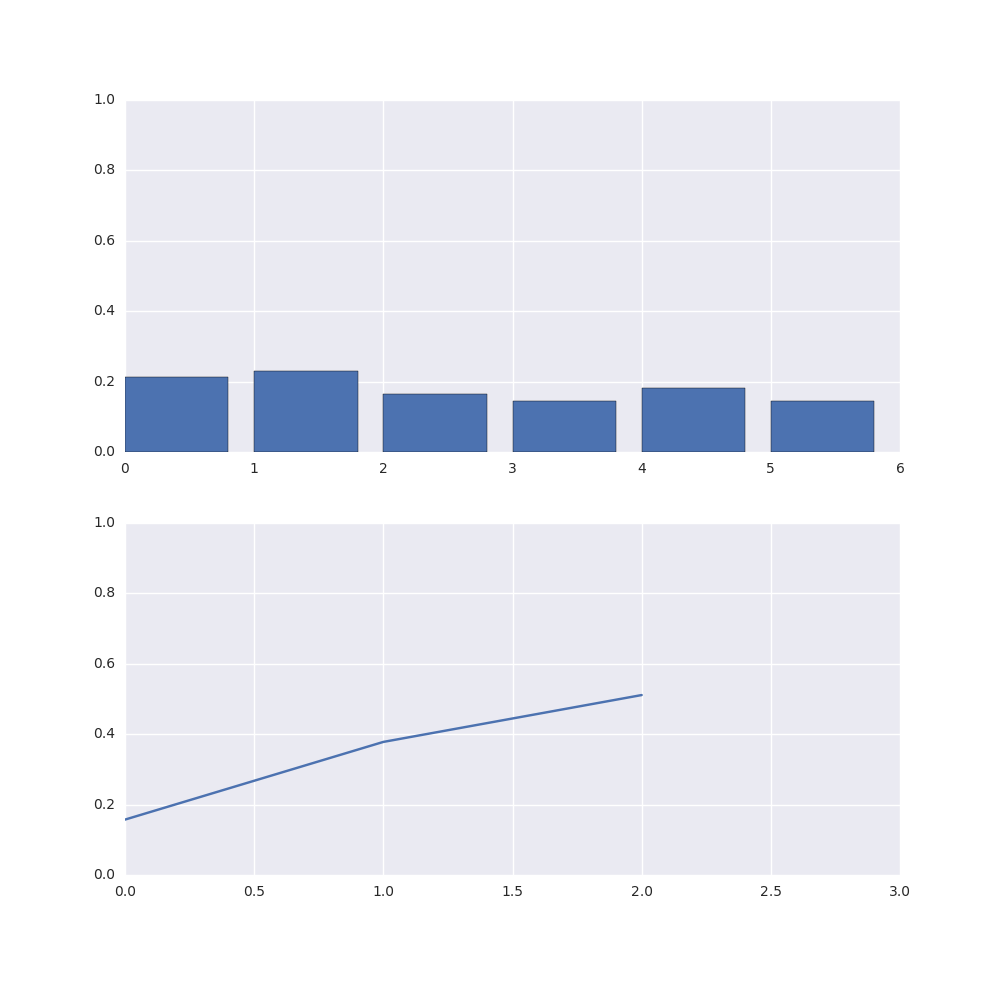
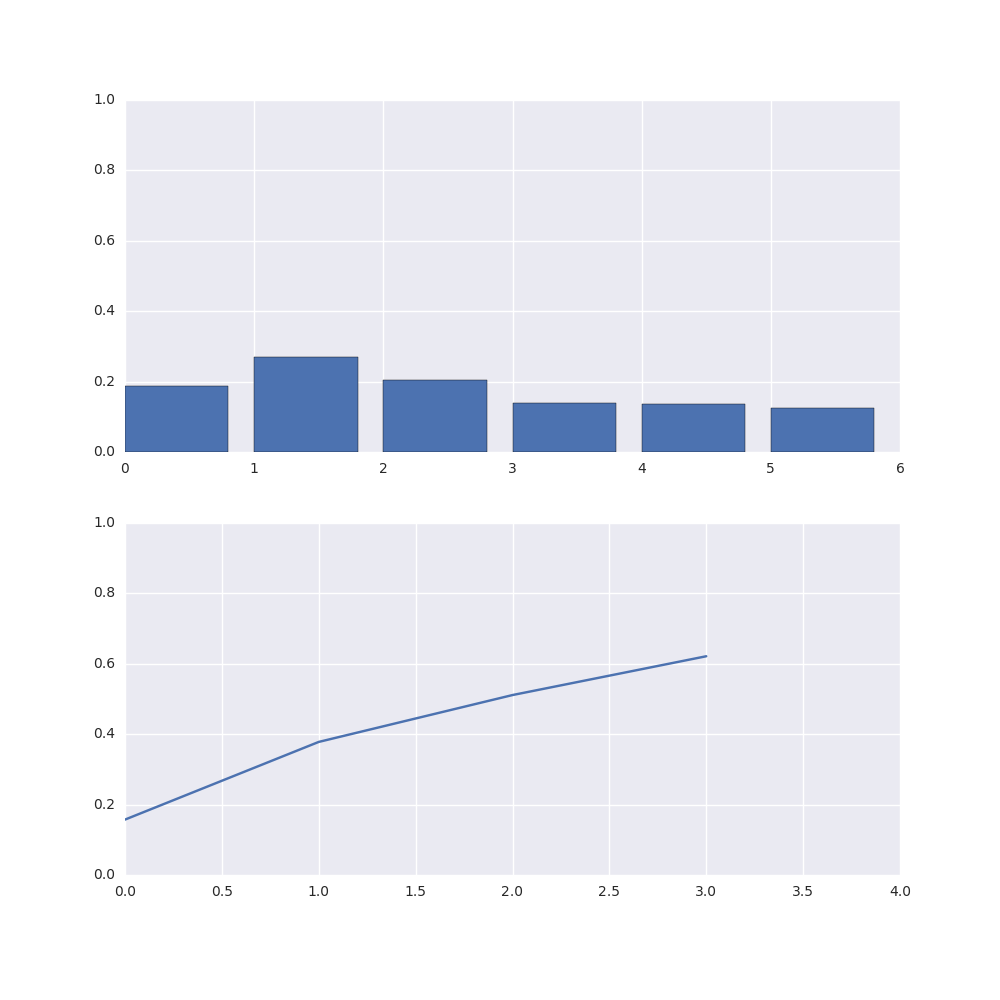
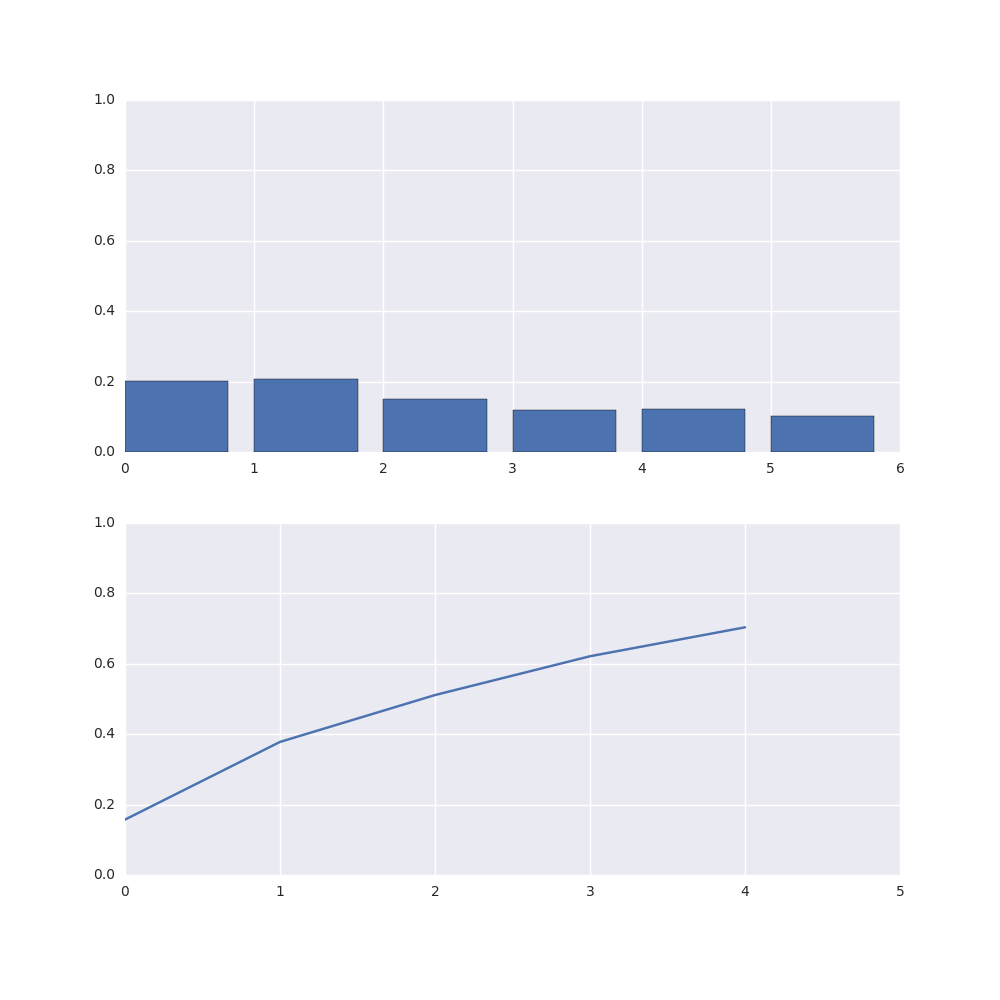
...
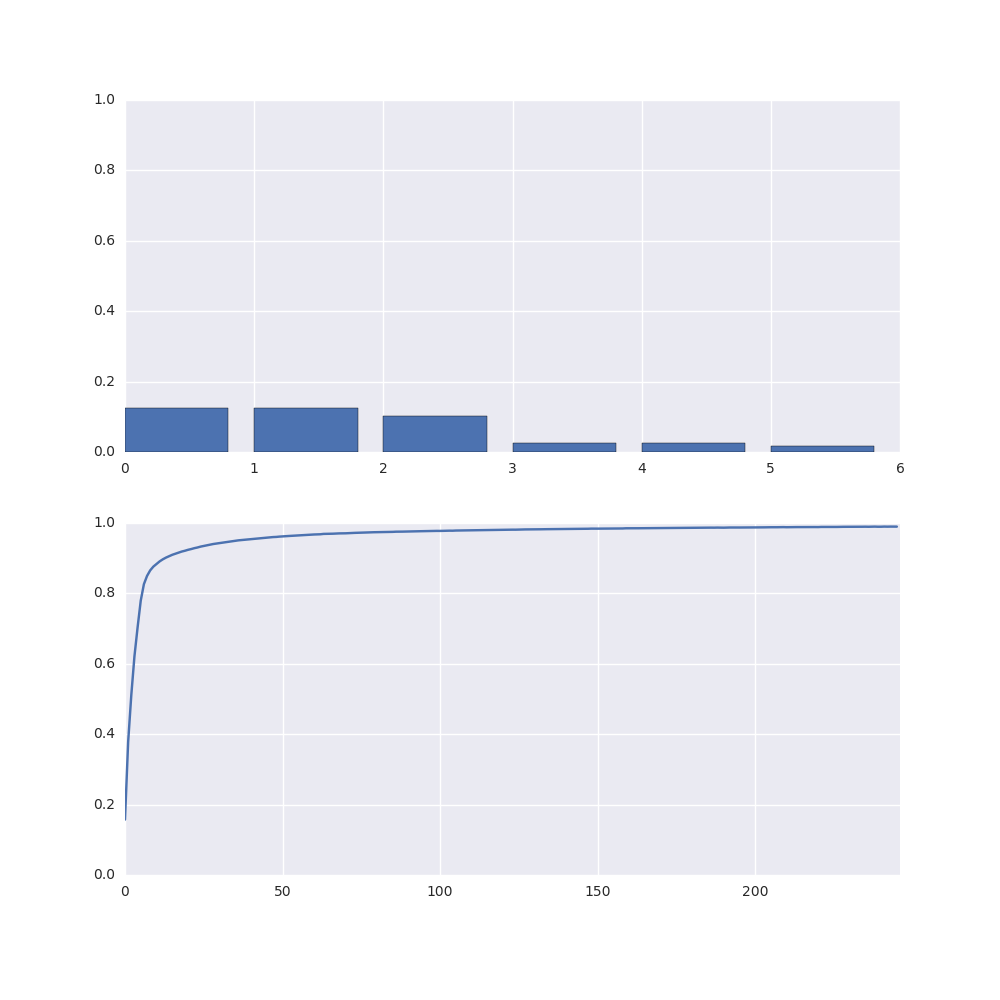
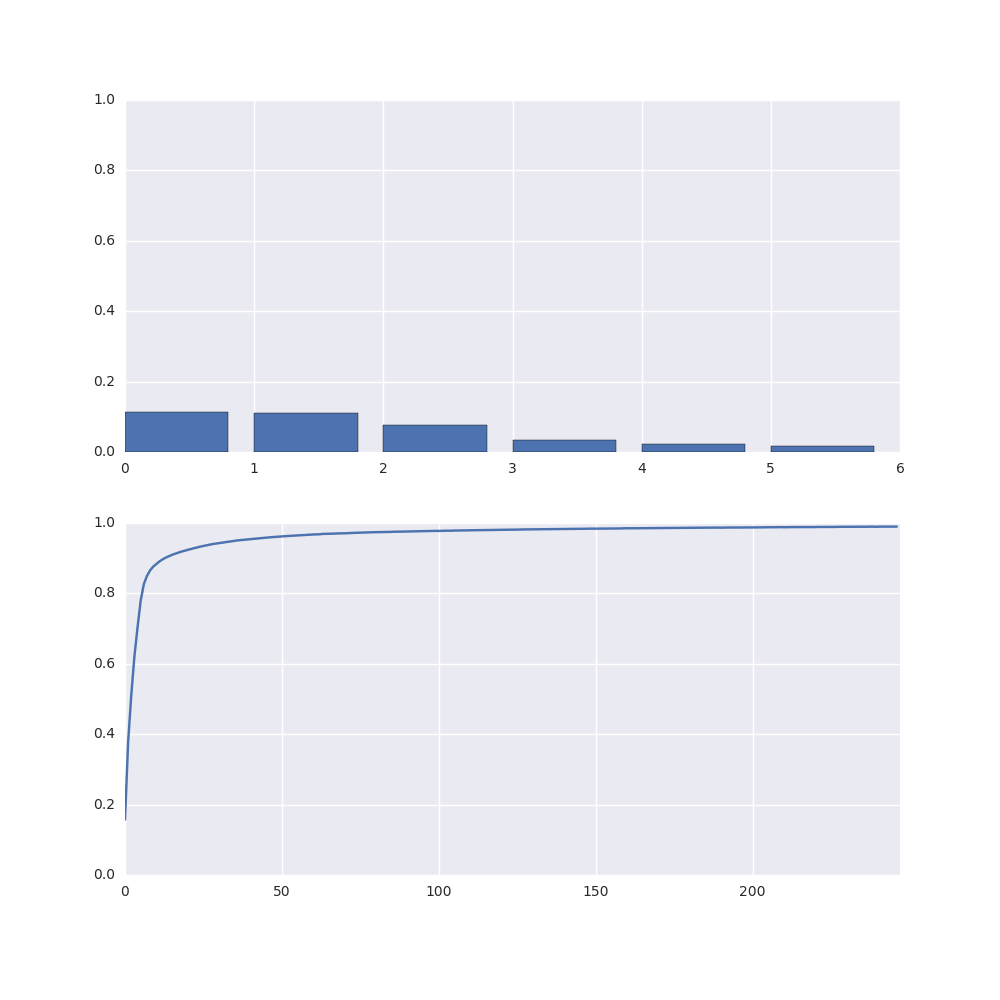
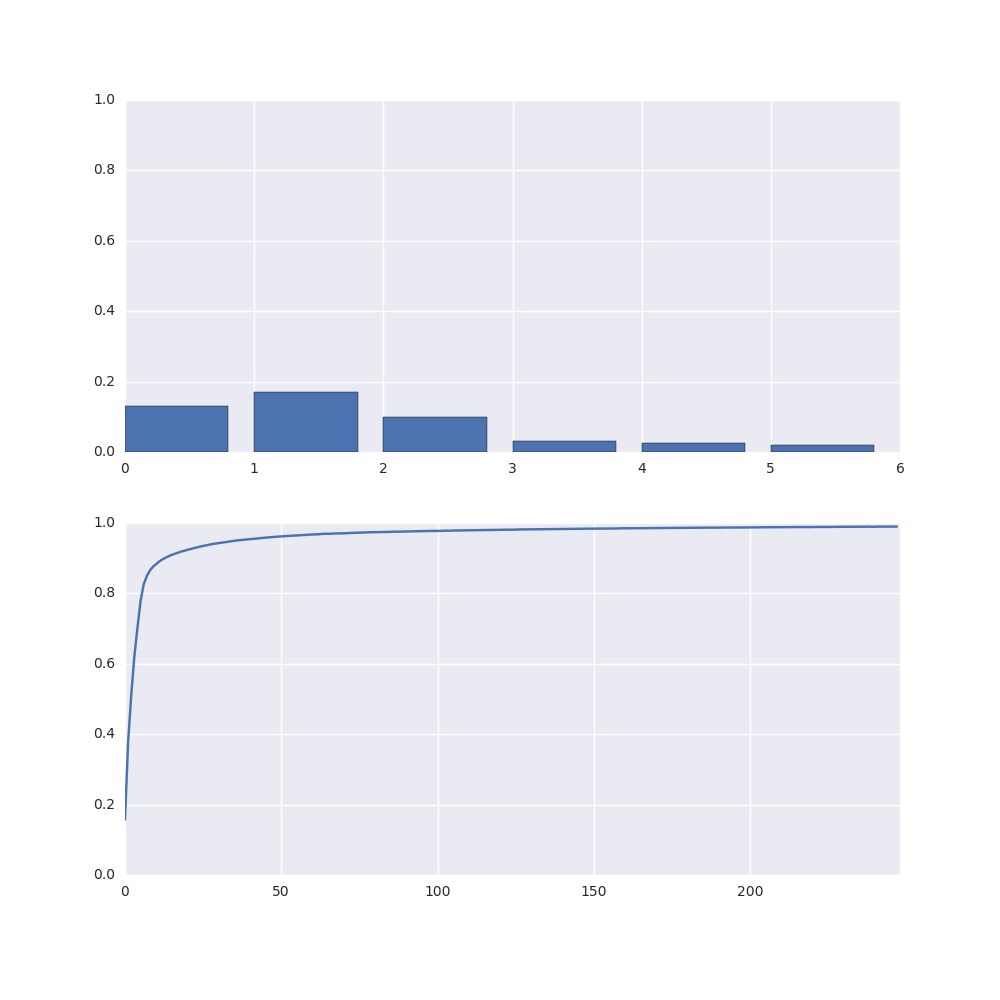
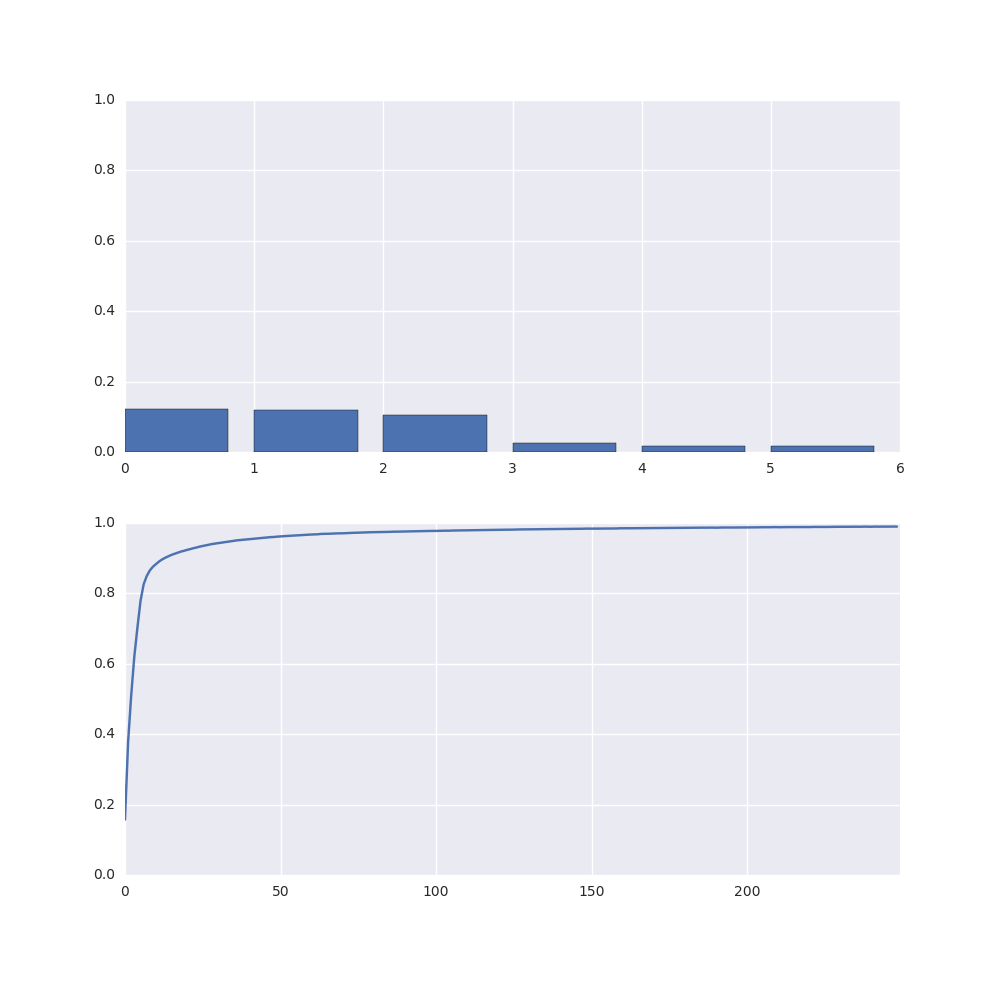
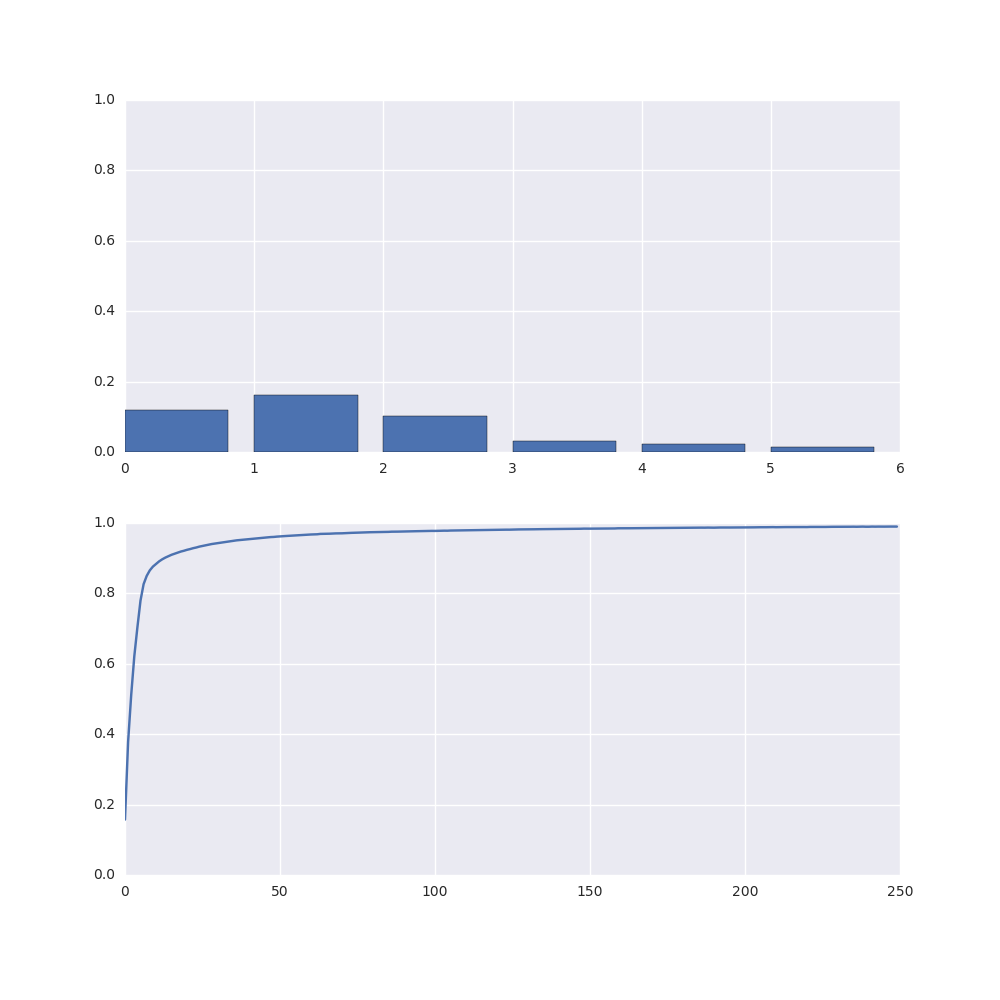

In [10]:
fig = plt.figure(dpi = 200, figsize=(10, 10))
ax01 = subplot2grid((2, 1), (0, 0))
ax02 = subplot2grid((2, 1), (1, 0))

# set y-limits
ax01.set_ylim(0,1.)
ax02.set_ylim(0,1.)



rects = ax01.bar(range(len(all_history[0][1])), 1 - np.array(all_history[0][1]))
line = ax02.plot(range(len(np.array(all_history[0][0][1]))), np.array(all_history[0][0][1]))

def animate(i):
    for rect, yi in zip(rects, 1 - np.array(all_history[i][1])):
        rect.set_height(yi)
    line[0].set_data(range(len(np.array(all_history[i][0][1]))), np.array(all_history[i][0][1]))
    ax02.set_xlim(0, len(np.array(all_history[i][0][1])))
    return rects

anim = animation.FuncAnimation(fig, animate, frames=len(all_history), interval=100)
display_animation(anim)

# Deep Skip 0-64

We then reproduce the pathologically deep model with 128 layers with a skip connection from layer 0 to layer 64. 

In [11]:
input_deep = Input(shape=(28 * 28, ))

models_prob_skip = []
x = Dense(128)(input_deep)
x = LeakyReLU(0.5)(x)
models_prob_skip.append(build_model_probs(input_deep, x, False))

outputs = []

for i in range(128):
    if i % 64 == 0 and i != 0:
        x = merge([x, input_deep], mode='concat')
    x = Dense(128)(x)
    x = LeakyReLU(0.5)(x)

    models_prob_skip.append(build_model_probs(input_deep, x, False))
    
x = Dense(10)(x)
x = Activation('softmax')(x)

model_skip = Model(input_deep, [x] + outputs)

In [12]:
adam = Adam(lr=0.00001)

In [13]:
model_skip.compile(loss='categorical_crossentropy',
                   optimizer=adam,
                   metrics=['accuracy'])

In [ ]:
scikit = True
all_history_skip = []
obs_sample = np.random.choice(X_train.shape[0], 2000)
X_train_sub = X_train[obs_sample]
Y_train_sub = np.argmax(Y_train[obs_sample], axis=1)
    
probs_model_skip = {l: LogisticRegression(warm_start=True) for l in models_prob_skip}
loss = []
acc = []
for i in range(nb_epoch):
    probs_histories = []
    for model_prob in models_prob_skip:
        if scikit:
            logreg = probs_model_skip[model_prob]
            features = model_prob.predict(X_train_sub.reshape(-1, 28 * 28))
            if features.shape[1] > r_features:
                col_sample = np.random.choice(features.shape[1], r_features)
                features = features[:, col_sample]
            logreg.fit(features, Y_train_sub)
            score = logreg.score(features, Y_train_sub)
            probs_histories.append(score)
        else:
            pass
    history = model_skip.fit(X_train.reshape(-1, 28 * 28), [Y_train] * len(model_skip.outputs), nb_epoch=1, batch_size=batch_size)
    ite_loss = loss + [history.history['loss']]
    loss = loss + [history.history['loss']]
    ite_acc = acc + [history.history['acc']]
    acc = acc + [history.history['acc']]
    
    all_history_skip.append(((ite_loss, ite_acc), probs_histories))

Here we reproduce the figures 8a, 8b, and 8c.


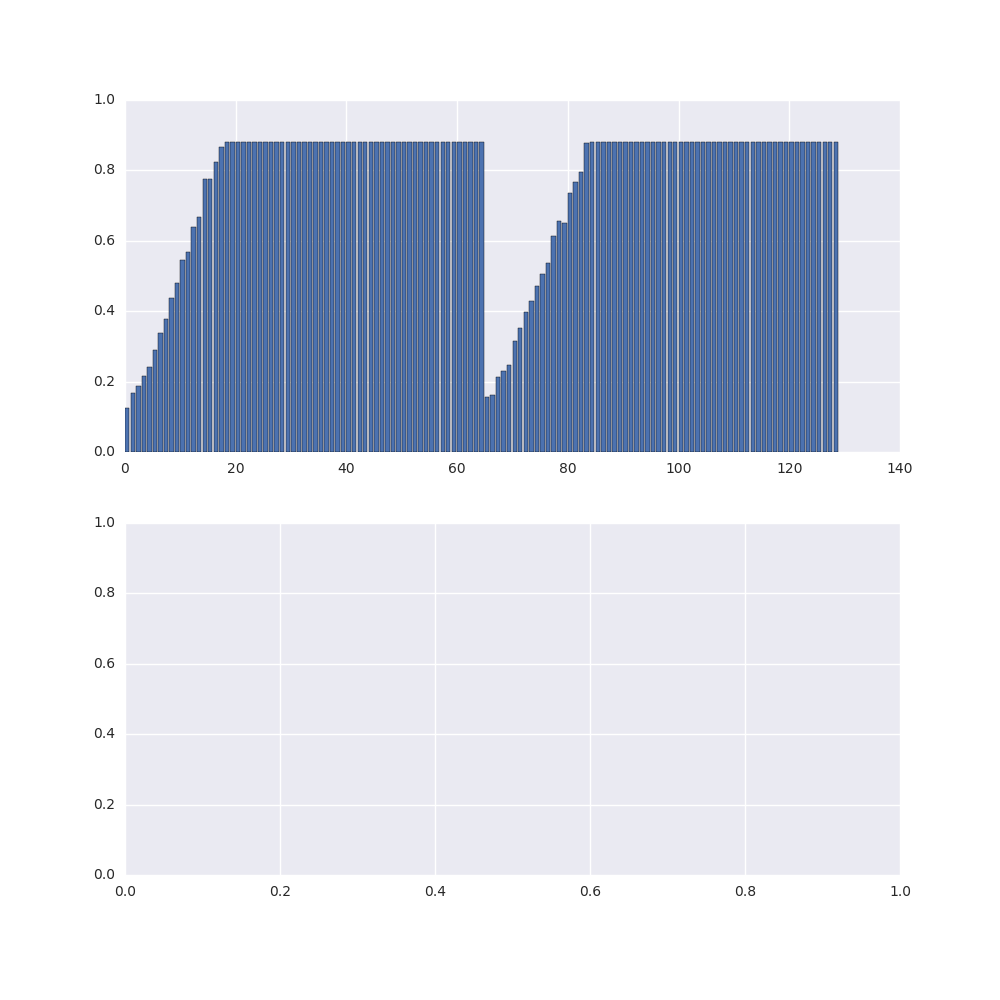
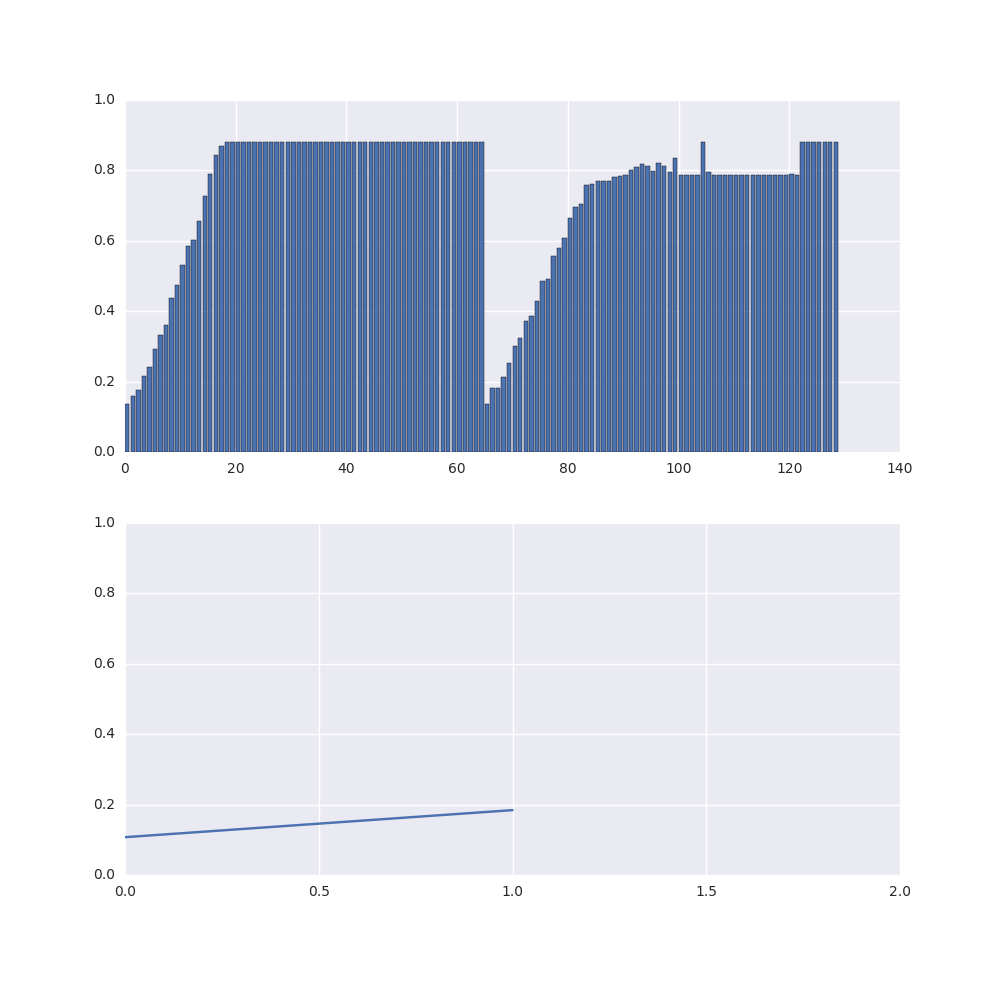
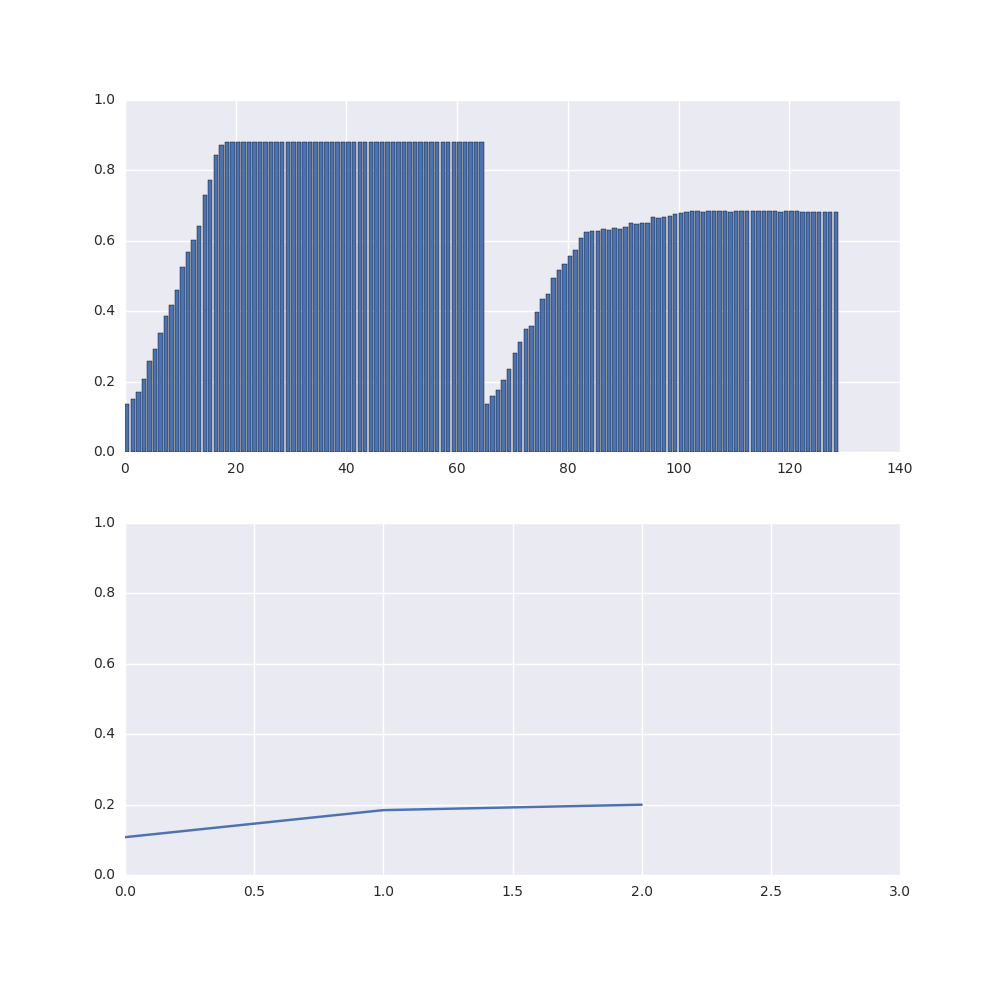
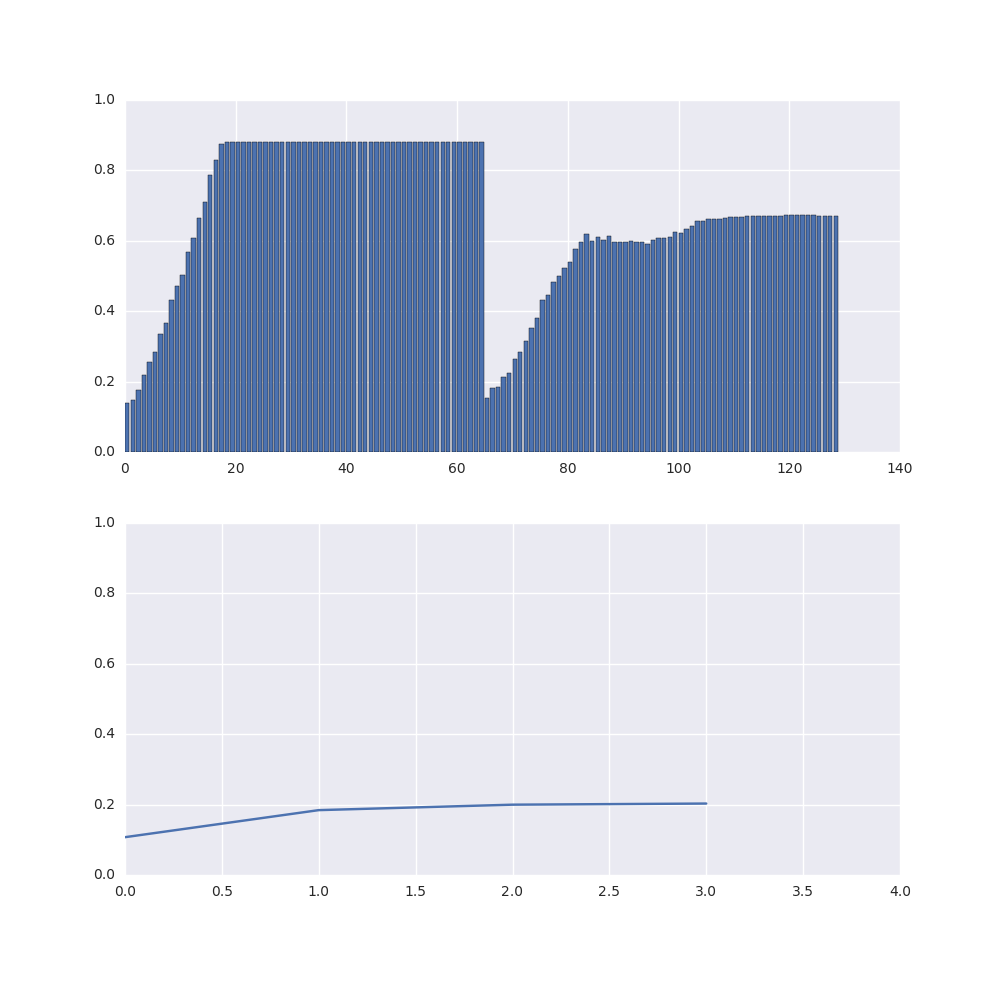
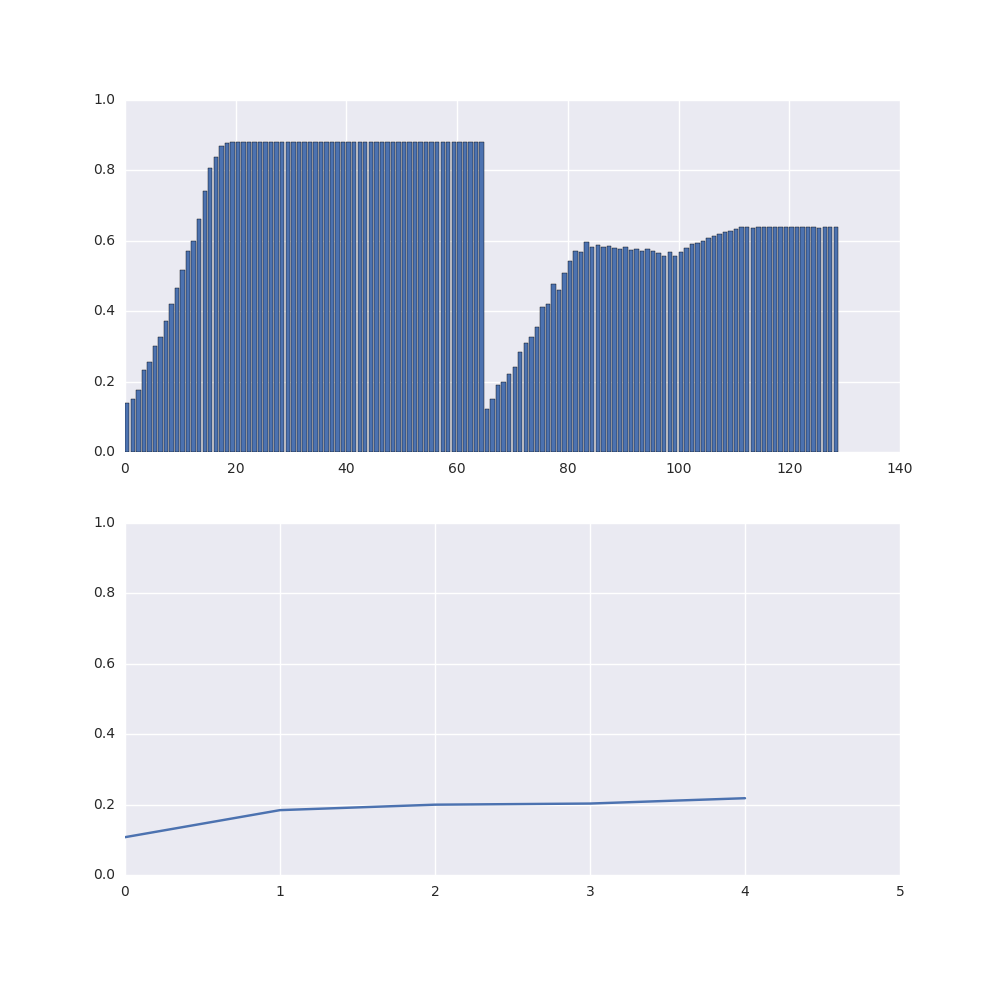
...
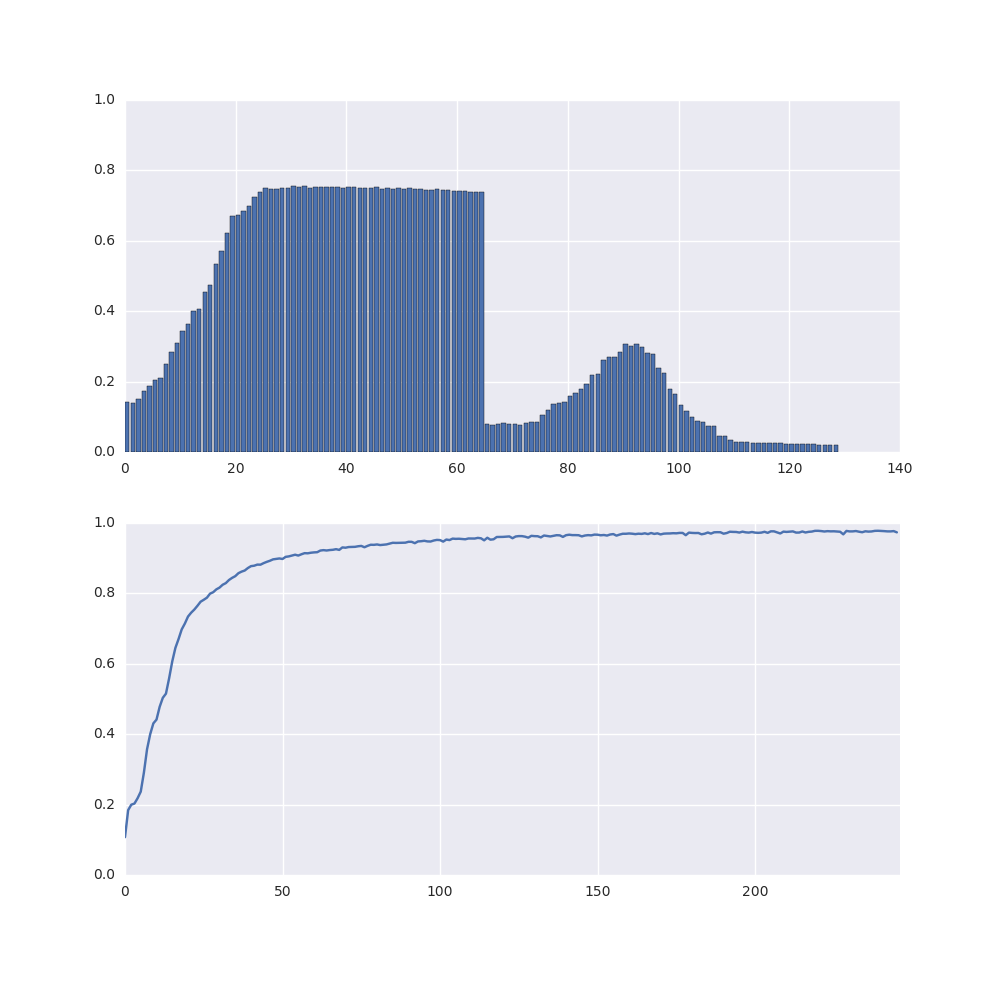
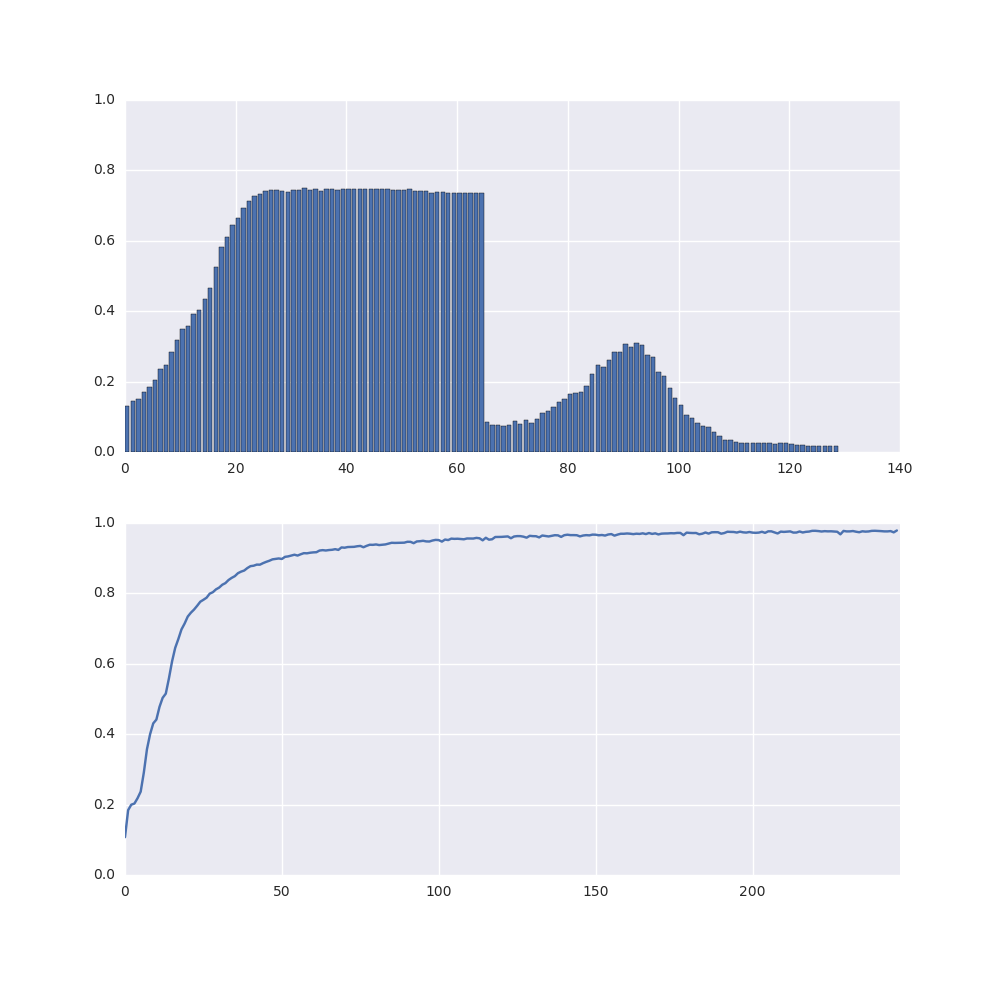
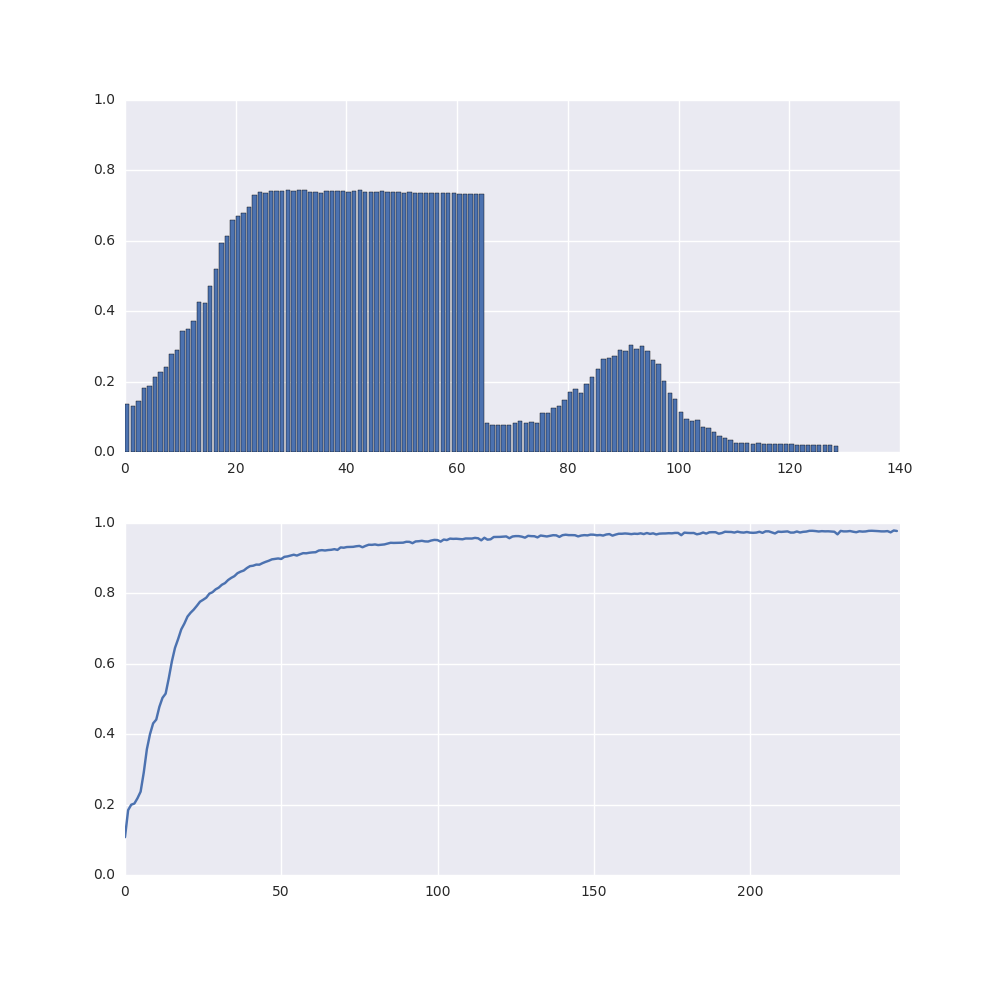
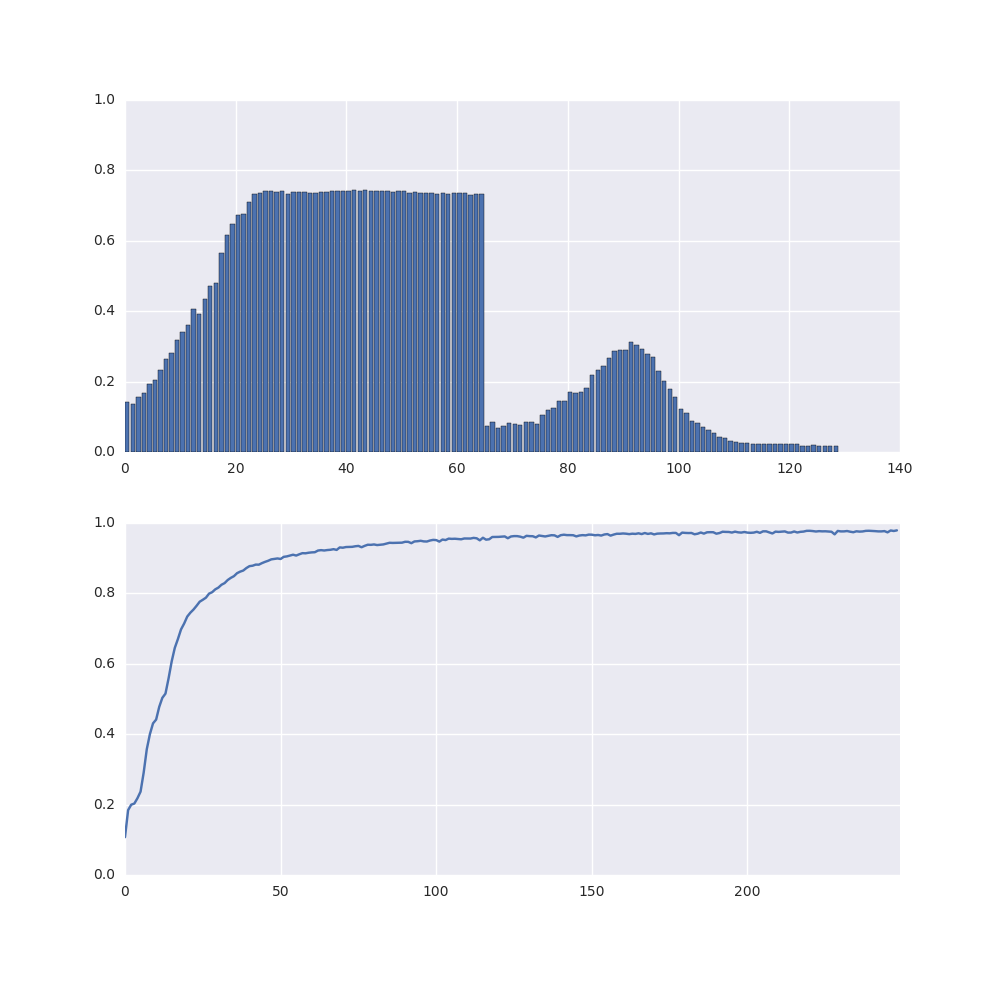
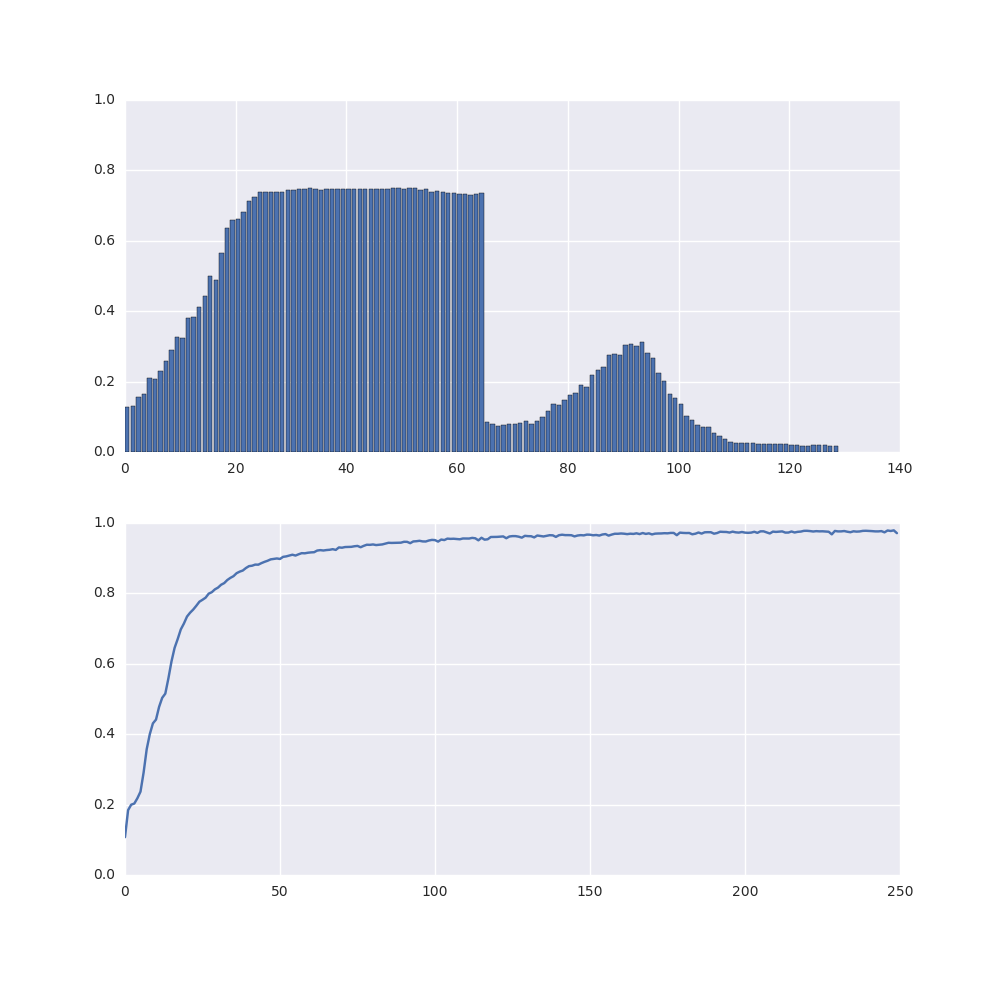

In [25]:
print()
print()
fig = plt.figure(dpi = 250, figsize=(10, 10))
ax01 = subplot2grid((2, 1), (0, 0))
ax02 = subplot2grid((2, 1), (1, 0))

# set y-limits
ax01.set_ylim(0,1.)
ax02.set_ylim(0,1.)



rects = ax01.bar(range(len(all_history_skip[0][1])), 1 - np.array(all_history_skip[0][1]))
line = ax02.plot(range(len(np.array(all_history_skip[0][0][1]))), np.array(all_history_skip[0][0][1]))

def animate(i):
    for rect, yi in zip(rects, 1- np.array(all_history_skip[i][1])):
        rect.set_height(yi)
    line[0].set_data(range(len(np.array(all_history_skip[i][0][1]))), np.array(all_history_skip[i][0][1]))
    ax02.set_xlim(0, len(np.array(all_history_skip[i][0][1])))
    return rects

anim = animation.FuncAnimation(fig, animate, frames=len(all_history_skip), interval=100)
display_animation(anim)

# Deep Auxiliary 

We then reproduce the pathologically deep model with 128 layers with auxiliary losses added at every 16 layers. 

In [16]:
input_deep = Input(shape=(28 * 28, ))

models_prob_aux = []
x = Dense(128)(input_deep)
x = LeakyReLU(0.5)(x)
models_prob_aux.append(build_model_probs(input_deep, x, False))

outputs = []

for i in range(128):
    x = Dense(128)(x)
    x = LeakyReLU(0.5)(x)
    if i % 16 == 0 and i != 0:
        outputs.append(build_inter_output(x, False))
    models_prob_aux.append(build_model_probs(input_deep, x, False))

x = Dense(10)(x)
x = Activation('softmax', name='output')(x)

model_aux = Model(input_deep, [x] + outputs)


In [17]:
adam = Adam(lr=0.00001)

In [18]:
model_aux.compile(loss='categorical_crossentropy',
                  optimizer=adam,
                  metrics=['accuracy'])

In [ ]:
scikit = True
all_history_aux = []
obs_sample = np.random.choice(X_train.shape[0], 2000)
X_train_sub = X_train[obs_sample]
Y_train_sub = np.argmax(Y_train[obs_sample], axis=1)
    
probs_model_aux = {l: LogisticRegression(warm_start=True) for l in models_prob_aux}
loss = []
acc = []
for i in range(nb_epoch):
    probs_histories = []
    for model_prob in models_prob_aux:
        if scikit:
            logreg = probs_model_aux[model_prob]
            features = model_prob.predict(X_train_sub.reshape(-1, 28 * 28))
            if features.shape[1] > r_features:
                col_sample = np.random.choice(features.shape[1], r_features)
                features = features[:, col_sample]
            logreg.fit(features, Y_train_sub)
            score = logreg.score(features, Y_train_sub)
            probs_histories.append(score)
        else:
            pass
    history = model_aux.fit(X_train.reshape(-1, 28 * 28), [Y_train] * len(model_aux.outputs), nb_epoch=1, batch_size=batch_size)
    ite_loss = loss + [history.history['loss']]
    loss = loss + [history.history['loss']]
    ite_acc = acc + [history.history['output_acc']]
    acc = acc + [history.history['output_acc']]
    
    all_history_aux.append(((ite_loss, ite_acc), probs_histories))

Here we reproduce figures 7a, 7b, and 7c.


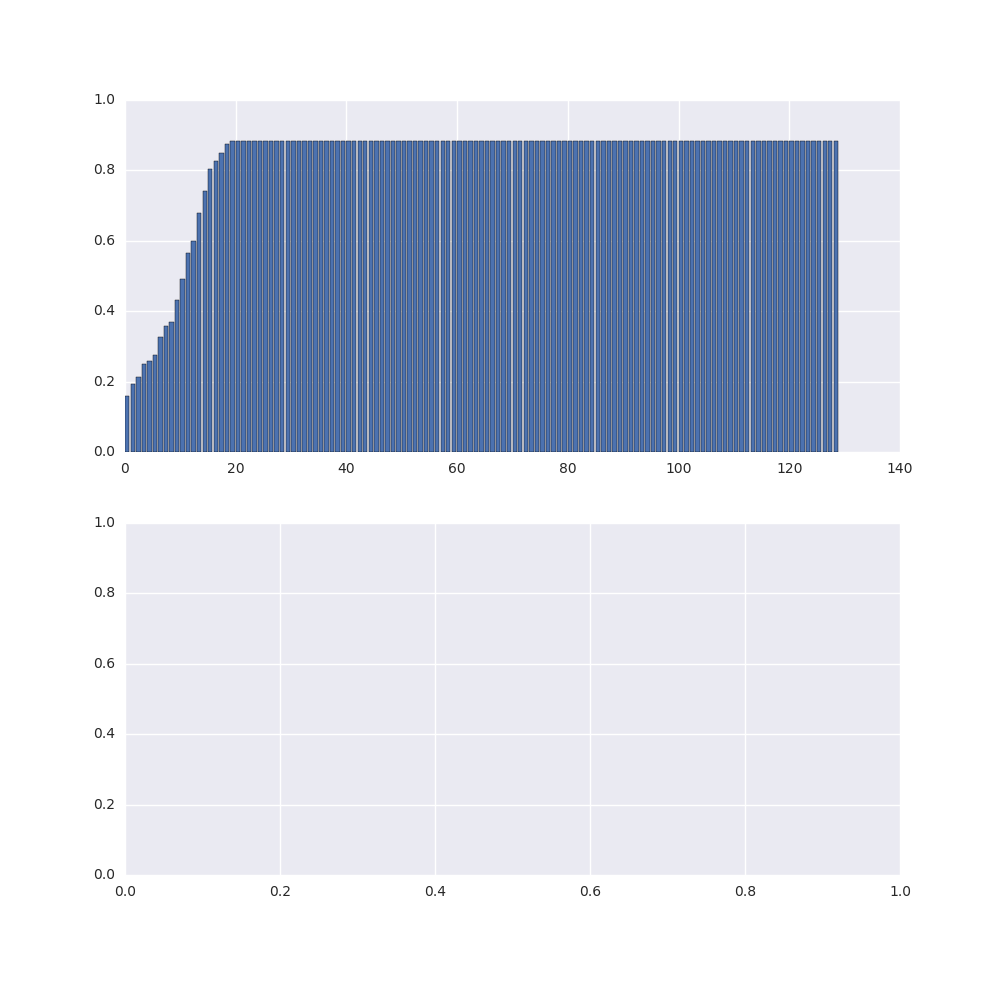
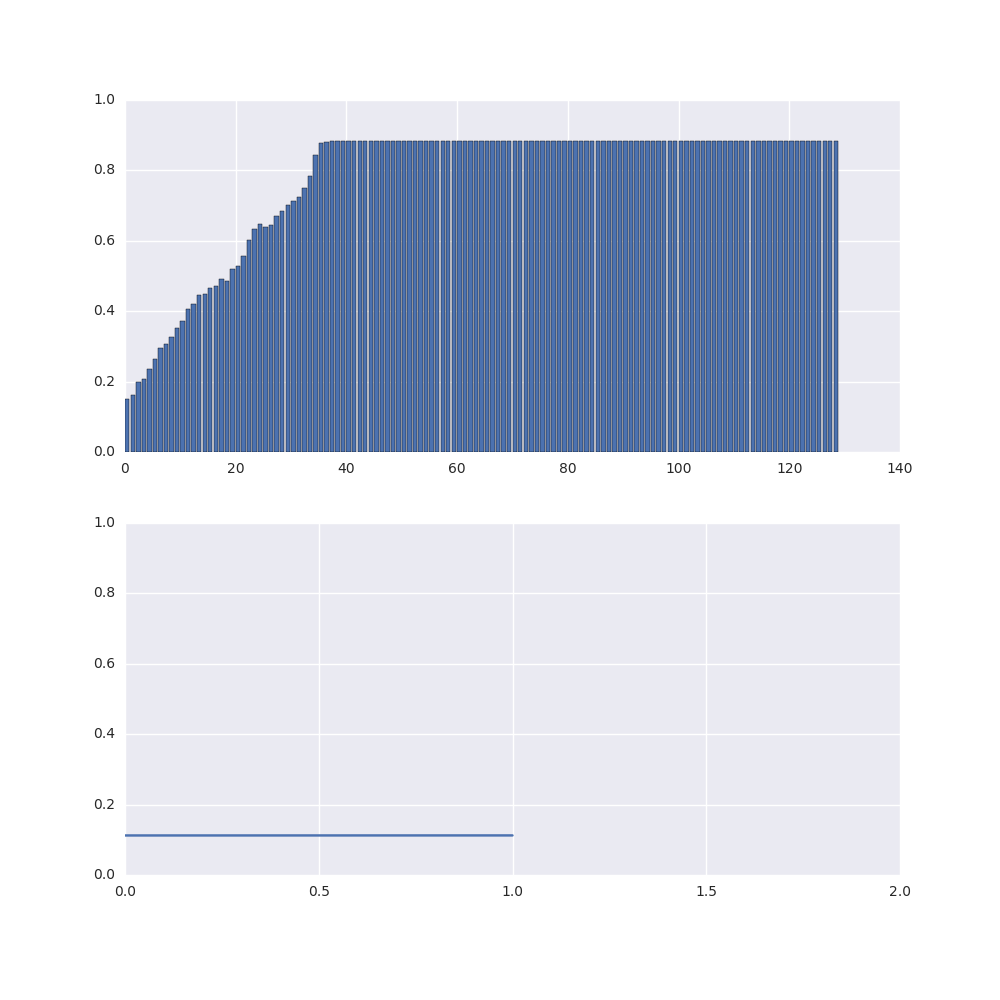
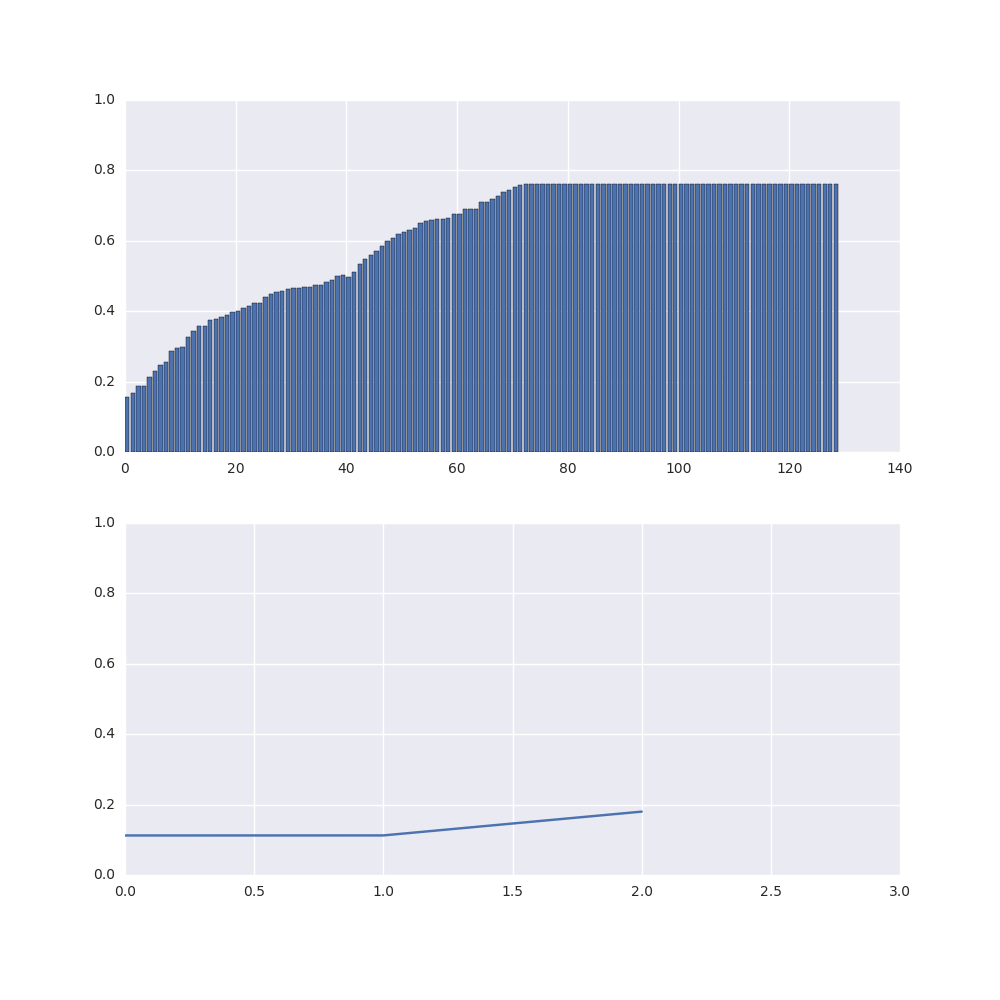
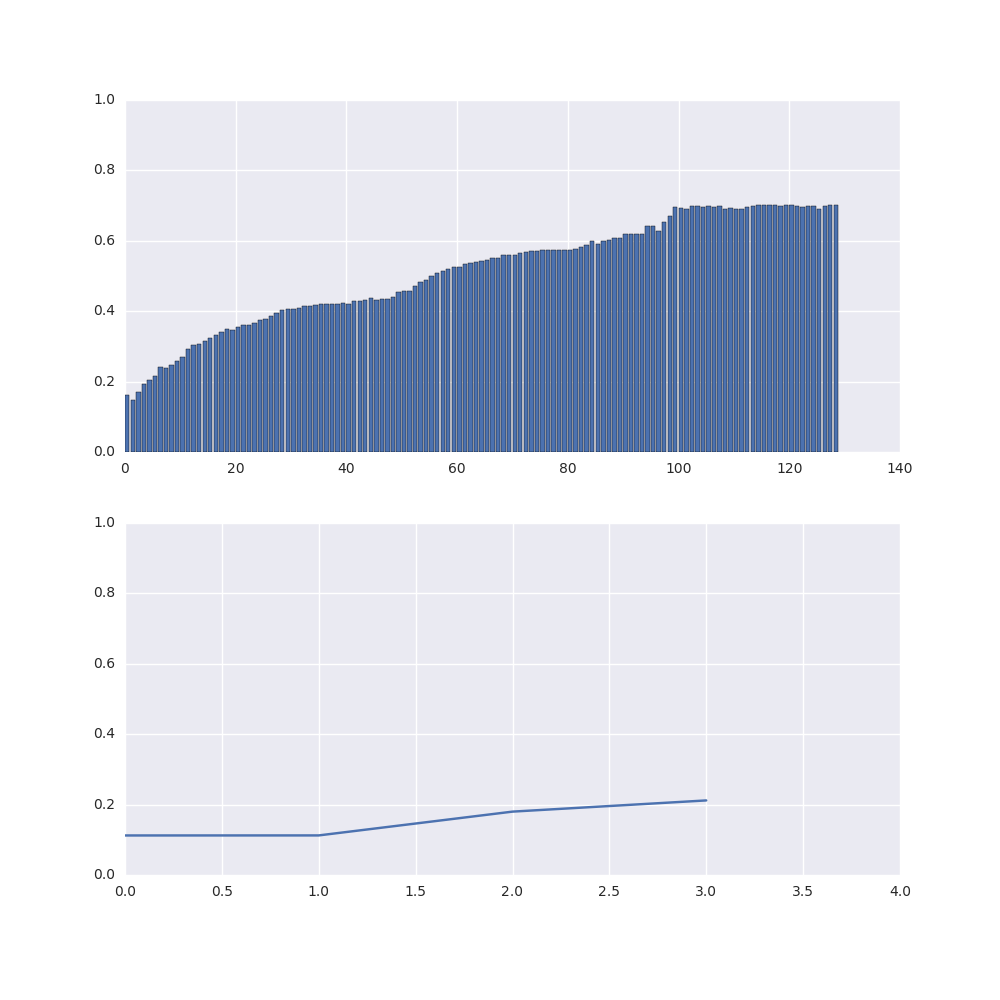
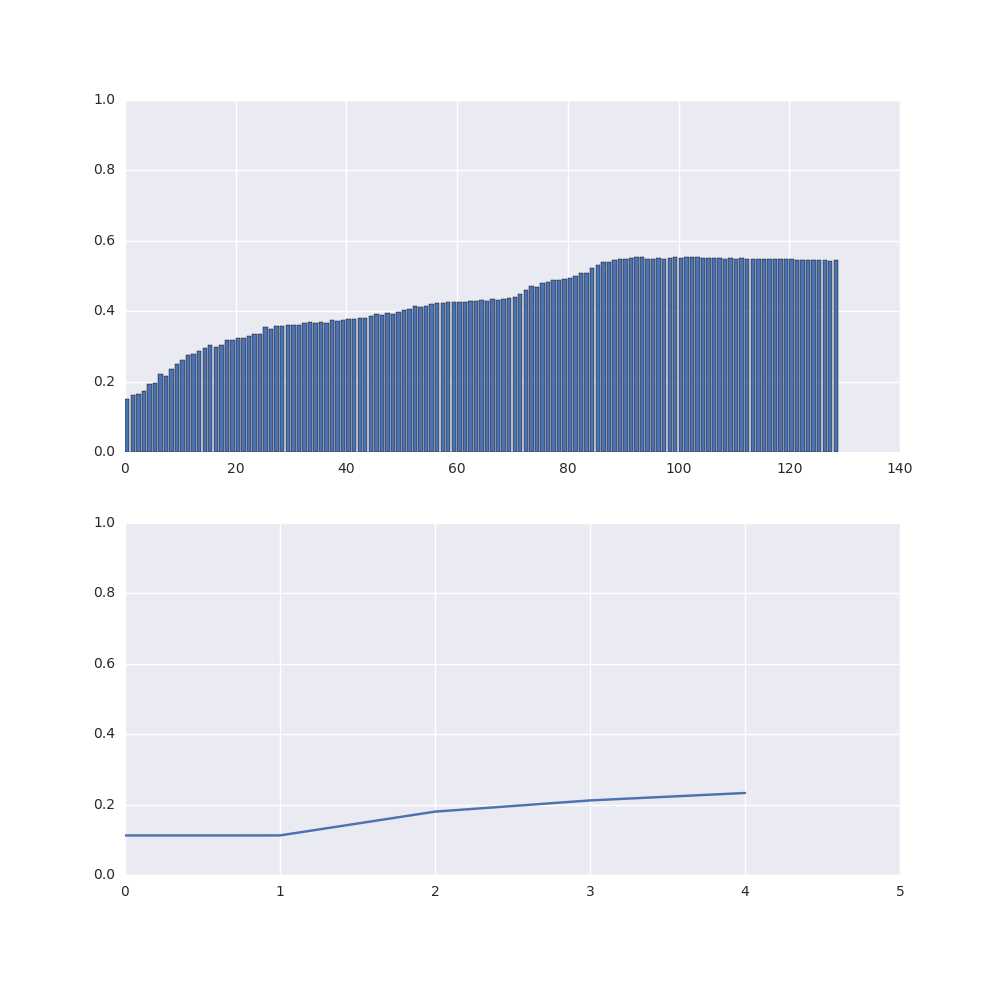
...
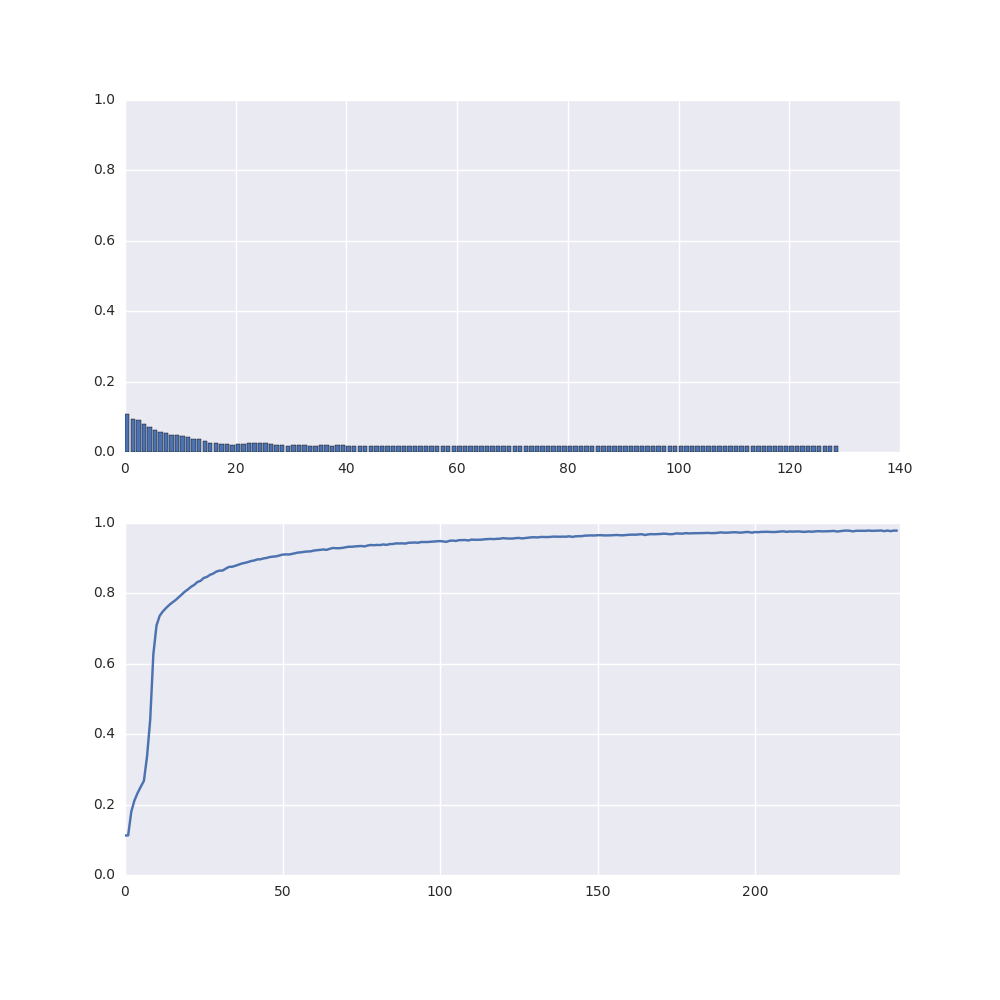
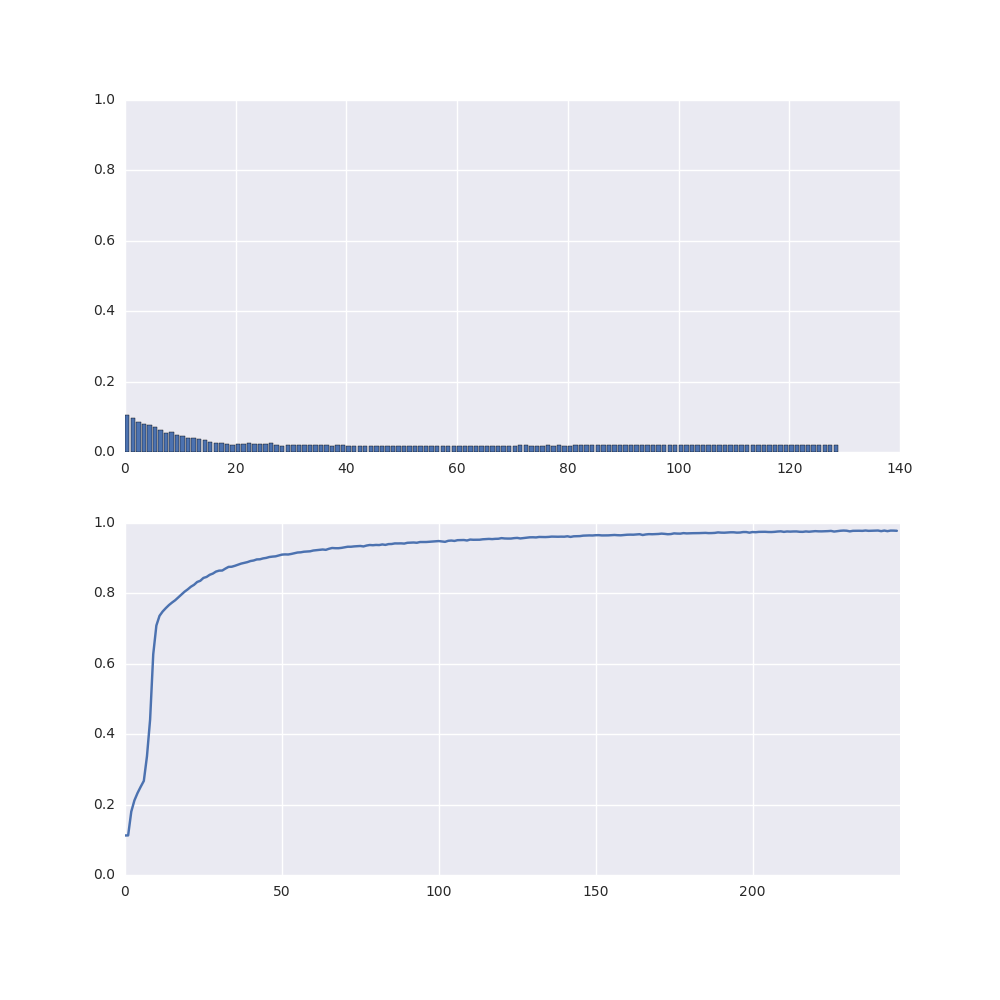
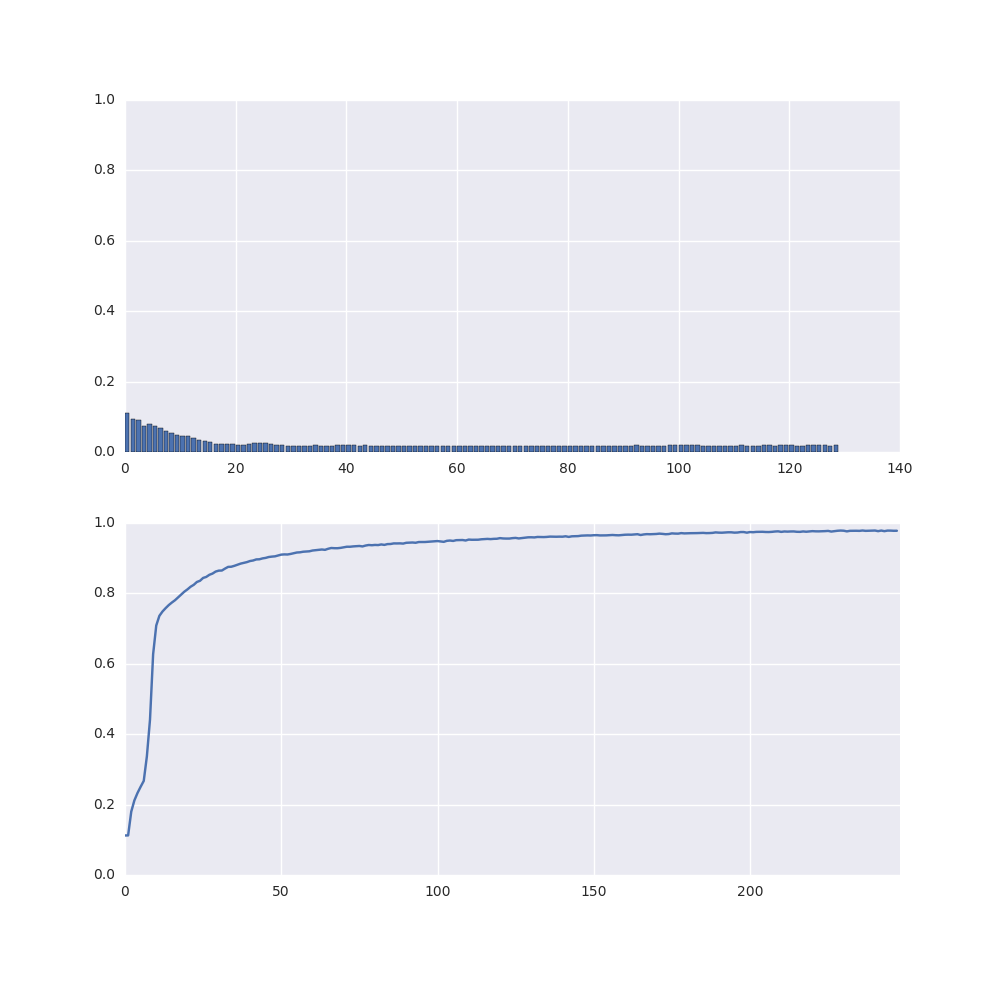
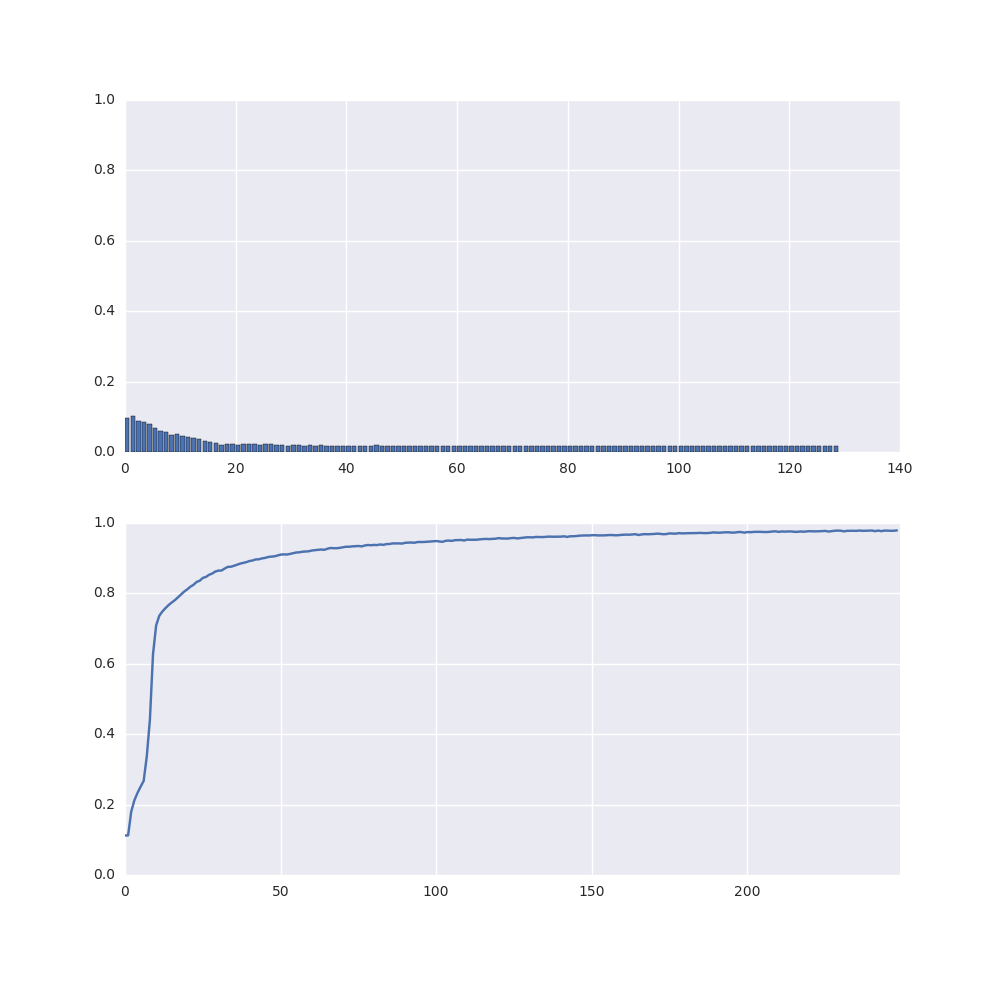
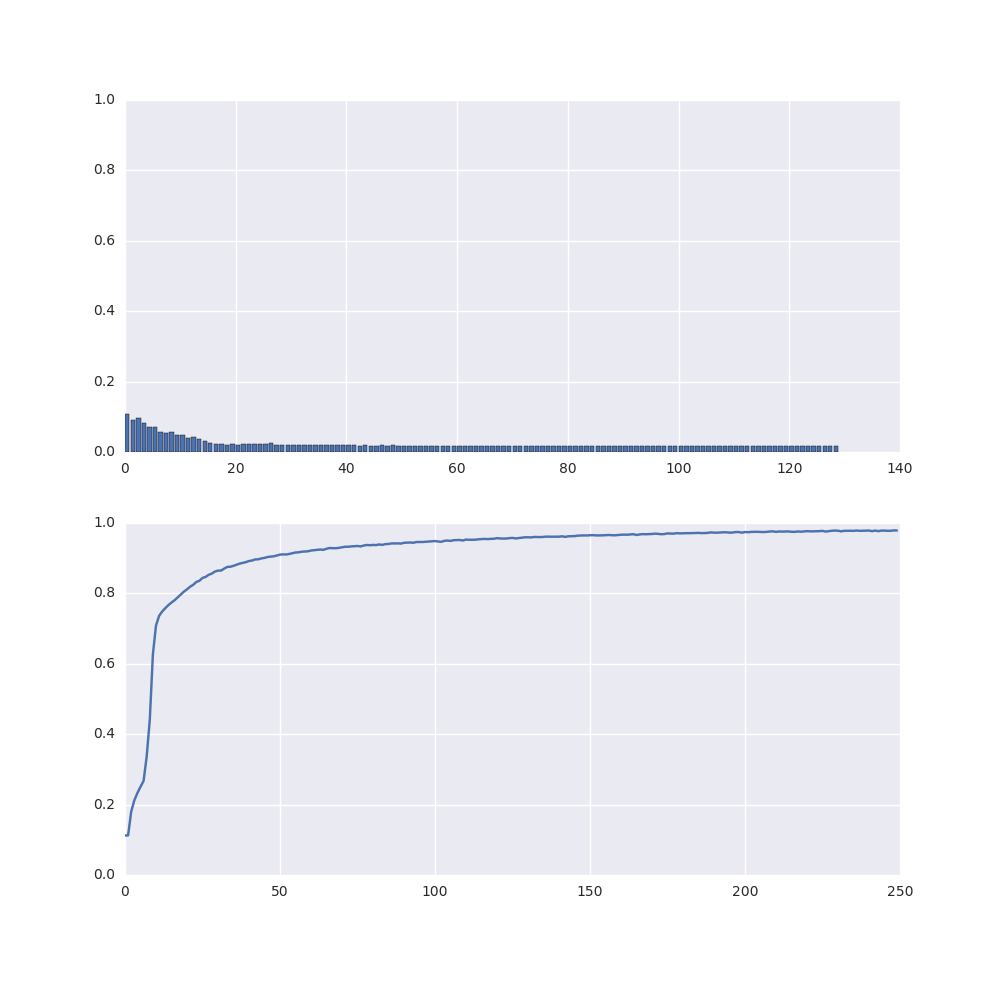

In [20]:
fig = plt.figure(dpi = 200, figsize=(10, 10))
ax01 = subplot2grid((2, 1), (0, 0))
ax02 = subplot2grid((2, 1), (1, 0))

# set y-limits
ax01.set_ylim(0,1.)
ax02.set_ylim(0,1.)



rects = ax01.bar(range(len(all_history_aux[0][1])), 1 - np.array(all_history_aux[0][1]))
line = ax02.plot(range(len(np.array(all_history_aux[0][0][1]))), np.array(all_history_aux[0][0][1]))

def animate(i):
    for rect, yi in zip(rects, 1 - np.array(all_history_aux[i][1])):
        rect.set_height(yi)
    line[0].set_data(range(len(np.array(all_history_aux[i][0][1]))), np.array(all_history_aux[i][0][1]))
    ax02.set_xlim(0, len(np.array(all_history_aux[i][0][1])))
    return rects

anim = animation.FuncAnimation(fig, animate, frames=len(all_history_aux), interval=100)
display_animation(anim)